## Singular Value Decomposition

This notebook demonstrates the Singular Value Decomposition (SVD) of a matrix $A$.

Given a real matrix $A \in \mathbb{R}^{m \times n}$, the SVD is a factorization of the form:
$$
A = U S V^T
$$
where:
- $U \in \mathbb{R}^{m \times r}$ contains the left singular vectors (orthonormal columns),
- $S \in \mathbb{R}^{r \times r}$ is a diagonal matrix with non-negative singular values $\sigma_1 \geq \sigma_2 \geq \cdots \geq \sigma_r > 0$,
- $V \in \mathbb{R}^{n \times r}$ contains the right singular vectors (orthonormal columns),
- $r = \text{rank}(A)$ is the effective rank of $A$.

The singular values $\sigma_i$ are the square roots of the eigenvalues of $A^T A$:
$$
A^T A v_i = \sigma_i^2 v_i
$$

This implementation computes the SVD by:
1. Calculating the eigenvalues and eigenvectors of $A^T A$.
2. Taking the square roots of the eigenvalues to obtain the singular values.
3. Sorting the singular values and corresponding vectors in descending order.
4. Computing $U$ using $U = A V S^{-1}$ for nonzero singular values.

This approach yields the reduced (economy) SVD, which is efficient for matrices with low rank.

In [3]:
using LinearAlgebra
function decompose(A::AbstractMatrix)
    Af = Float64.(A)
    m, n = size(Af)

    # eigen of A'A -> V and squared singular values
    Eig = eigen(Symmetric(Af' * Af)) # "Symmetric" to avoid numerical issues, and force the matrix to be symmetric
    vals = clamp.(Eig.values, 0.0, Inf) # avoid tiny negative artifacts, it turns out that eigenvalues will always be non-negative
    sigma = sqrt.(vals)

    # sort descending and form V
    idx = sortperm(sigma, rev=true) # returns a vector of indices that would sort the array
    sigma = sigma[idx]
    V = Eig.vectors[:, idx]

    # tolerance and effective rank
    tol = maximum(size(Af)) * eps(Float64) * (maximum(sigma) == 0 ? 1.0 : maximum(sigma))
    r = count(x -> x > tol, sigma)
    if r == 0
        return zeros(m, 0), Diagonal(zeros(0)), zeros(0, n)  # zero matrix case
    end

    # reduced/economy SVD: U (m×r), S (r×r), Vt (r×n)
    sigma_r = sigma[1:r]
    V_r = V[:, 1:r]
    U_r = Af * V_r * Diagonal(1.0 ./ sigma_r)

    return U_r, Diagonal(sigma_r), V_r'
end


decompose (generic function with 1 method)

In [4]:
n = rand(2:20)  # Random size between 2 and 20
m = rand(2:20)

A = rand(n, m).*2 - ones(n,m)  # Example matrix with both positive and negative values
display("Original Matrix A:")
display(A)
U_custom, S_custom, Vt_custom = decompose(A)

A_reconstructed = U_custom * S_custom * Vt_custom
display("Reconstructed Matrix A:")
display(A_reconstructed)


display(A ≈ A_reconstructed)  # Should be true

"Original Matrix A:"

15×14 Matrix{Float64}:
  0.0869861  -0.0402299  -0.912961   …   0.582834    -0.791827   -0.850489
  0.960985   -0.0991398  -0.741786      -0.594819     0.704425    0.140388
  0.190494    0.959663    0.0498445     -0.989178    -0.348658    0.582305
 -0.909622   -0.932276    0.47825       -0.130376    -0.103749    0.845035
 -0.162426   -0.301724    0.864428       0.12799     -0.594822   -0.609925
 -0.989841   -0.425726    0.57086    …  -0.587405     0.336933    0.795532
 -0.166316   -0.971123    0.122176      -0.781419    -0.671607    0.843106
 -0.615669   -0.664792   -0.0189163     -0.00561691   0.179844   -0.104426
 -0.85592    -0.098685    0.0224532     -0.258009     0.617852   -0.0731476
  0.910986   -0.169238   -0.661454      -0.468028    -0.0888178   0.96312
  0.353771    0.229739   -0.0169142  …   0.152407     0.0861947   0.814038
 -0.693549   -0.0710931   0.0369506      0.653238     0.373024   -0.318576
  0.355777   -0.839076    0.173444       0.894432     0.270659   -0.390609
 -

"Reconstructed Matrix A:"

15×14 Matrix{Float64}:
  0.0869861  -0.0402299  -0.912961   …   0.582834    -0.791827   -0.850489
  0.960985   -0.0991398  -0.741786      -0.594819     0.704425    0.140388
  0.190494    0.959663    0.0498445     -0.989178    -0.348658    0.582305
 -0.909622   -0.932276    0.47825       -0.130376    -0.103749    0.845035
 -0.162426   -0.301724    0.864428       0.12799     -0.594822   -0.609925
 -0.989841   -0.425726    0.57086    …  -0.587405     0.336933    0.795532
 -0.166316   -0.971123    0.122176      -0.781419    -0.671607    0.843106
 -0.615669   -0.664792   -0.0189163     -0.00561691   0.179844   -0.104426
 -0.85592    -0.098685    0.0224532     -0.258009     0.617852   -0.0731476
  0.910986   -0.169238   -0.661454      -0.468028    -0.0888178   0.96312
  0.353771    0.229739   -0.0169142  …   0.152407     0.0861947   0.814038
 -0.693549   -0.0710931   0.0369506      0.653238     0.373024   -0.318576
  0.355777   -0.839076    0.173444       0.894432     0.270659   -0.390609
 -

true

---

## Decomposing an Image

In [5]:
using Pkg
Pkg.status()

Status `C:\Users\aryan\.julia\environments\tensors\Project.toml`
⌃ [5789e2e9] FileIO v1.17.0
  [e9467ef8] GLMakie v0.13.6
⌃ [9136182c] ITensors v0.9.11
  [4e3cecfd] ImageShow v0.3.8
  [02fcd773] ImageTransformations v0.10.2
  [916415d5] Images v0.26.2
Info Packages marked with ⌃ have new versions available and may be upgradable.


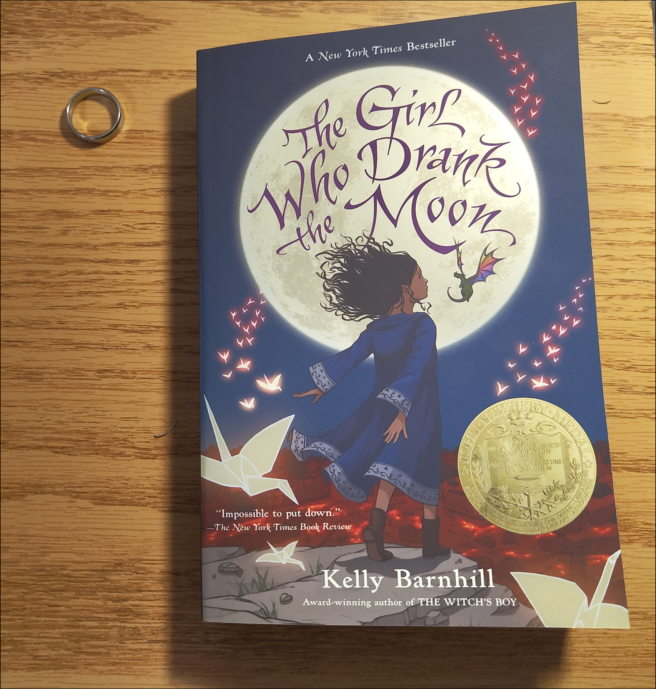

In [6]:
using FileIO
using ImageShow

img = load("image.jpg")

In [7]:
typeof(img)

Matrix{RGB{N0f8}} (alias for Array{ColorTypes.RGB{FixedPointNumbers.Normed{UInt8, 8}}, 2})

In [8]:
# rgbdata2Image(data::Union{<:AbstractMatrix{<:NTuple{3, <:Number}}, <:AbstractMatrix{<:AbstractVector{<:Number}}}) = reshape([ImageShow.ColorTypes.RGB{Float64}(d...) for d in vec(data)], size(data,1), size(data,2))
# red2Image(data::AbstractMatrix{<:Number}) = reshape([ImageShow.ColorTypes.RGB{Float64}(d, 0.0, 0.0) for d in vec(data)], size(data,1), size(data,2))
# green2Image(data::AbstractMatrix{<:Number}) = reshape([ImageShow.ColorTypes.RGB{Float64}(0.0, d, 0.0) for d in vec(data)], size(data,1), size(data,2))
# blue2Image(data::AbstractMatrix{<:Number}) = reshape([ImageShow.ColorTypes.RGB{Float64}(0.0, 0.0, d) for d in vec(data)], size(data,1), size(data,2))
# luminosity2Image(data::AbstractMatrix{<:Number}) = reshape([ImageShow.ColorTypes.RGB{Float64}(d, d, d) for d in vec(data)], size(data,1), size(data,2))

# image2rgbdata(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = reshape([[p.r, p.g, p.b] for p in vec(img)], size(img,1), size(img,2))
# image2red(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB})   = reshape([p.r for p in vec(img)], size(img,1), size(img,2))
# image2green(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = reshape([p.g for p in vec(img)], size(img,1), size(img,2))
# image2blue(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB})  = reshape([p.b for p in vec(img)], size(img,1), size(img,2))


# Convert a matrix of RGB tuples/vectors to an RGB image matrix
rgbdata2Image(data::Union{<:AbstractMatrix{<:NTuple{3, <:Number}}, <:AbstractMatrix{<:AbstractVector{<:Number}}}) = map(d -> ImageShow.ColorTypes.RGB{Float64}(d...), data)

# Convert a matrix of red channel values to an RGB image matrix (green and blue set to 0.0)
red2Image(data::AbstractMatrix{<:Number}) = map(d -> ImageShow.ColorTypes.RGB{Float64}(d, 0.0, 0.0), data)

# Convert a matrix of green channel values to an RGB image matrix (red and blue set to 0.0)
green2Image(data::AbstractMatrix{<:Number}) = map(d -> ImageShow.ColorTypes.RGB{Float64}(0.0, d, 0.0), data)

# Convert a matrix of blue channel values to an RGB image matrix (red and green set to 0.0)
blue2Image(data::AbstractMatrix{<:Number}) = map(d -> ImageShow.ColorTypes.RGB{Float64}(0.0, 0.0, d), data)

# Convert a matrix of luminosity values to an RGB image matrix (all channels equal)
luminosity2Image(data::AbstractMatrix{<:Number}) = map(d -> ImageShow.ColorTypes.RGB{Float64}(d, d, d), data)

# Convert an RGB image matrix to a matrix of [r, g, b] vectors
image2rgbdata(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = map(p -> [p.r, p.g, p.b], img)

# Extract red channel from an RGB image matrix
image2red(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = map(p -> p.r, img)

# Extract green channel from an RGB image matrix
image2green(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = map(p -> p.g, img)

# Extract blue channel from an RGB image matrix
image2blue(img::AbstractMatrix{<:ImageShow.ColorTypes.RGB}) = map(p -> p.b, img)


combine_rgb_data(A, B, C) = map((r, g, b) -> (r, g, b), A, B, C)


combine_rgb_data (generic function with 1 method)

In [9]:
red2Image(img2red(img))

UndefVarError: UndefVarError: `img2red` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

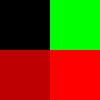

In [10]:
A =[
    (0.0, 0.0, 0.0) (0.25, 0.0, 0.0)
    (0.75, 0.0, 0.0) (1.0, 0.0, 0.0)
]


A[1,2] = (0.0, 1.0, 0.0)

rgbdata2Image(A)

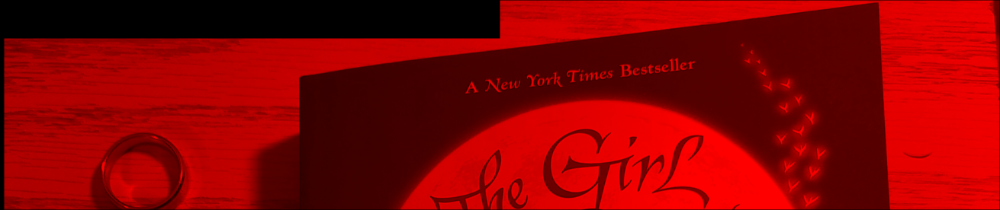

In [11]:
A = image2red(img)
A[:, 1:10] .= 0.0  # Set the first 10 columns to zero
A[1:100, 1:(size(A,2)÷2)] .= 0.0  # Set the first 100 rows to zero

red2Image(A[1:size(A,1)÷5, 1:size(A,2)]) # Display a portion of the modified image

## Apply SVD and Reduce the Quality of Images

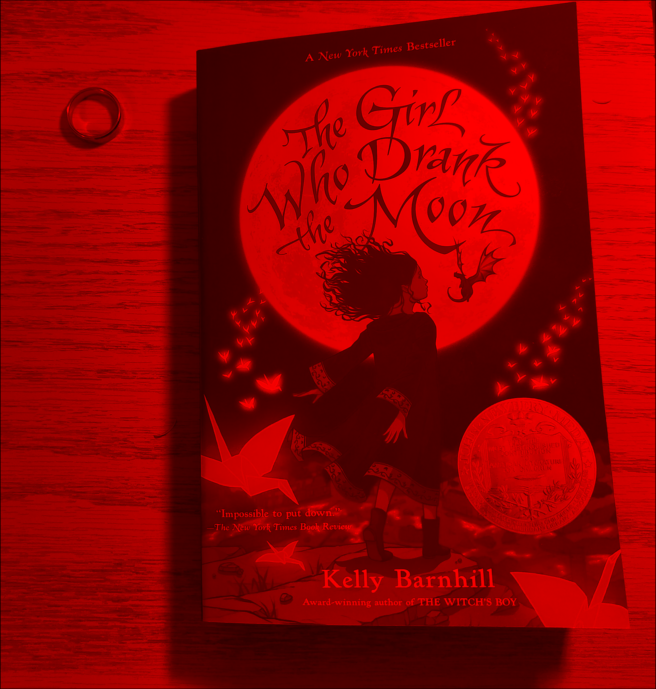

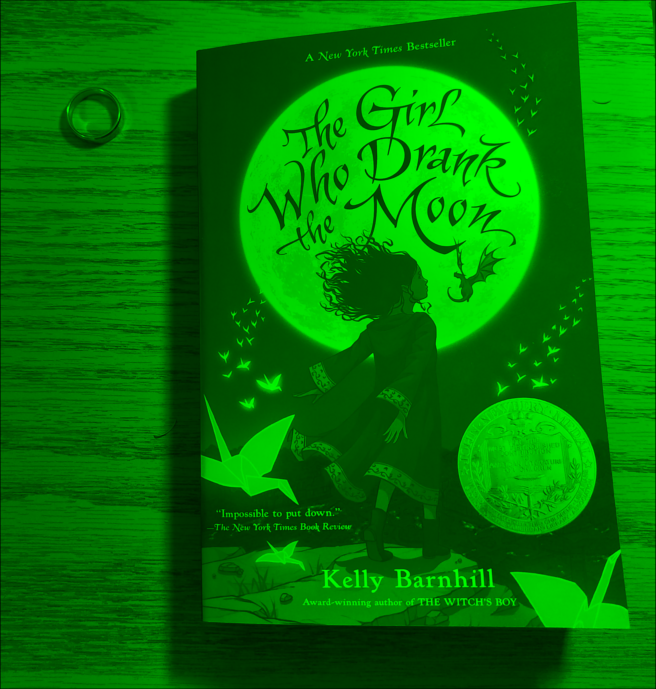

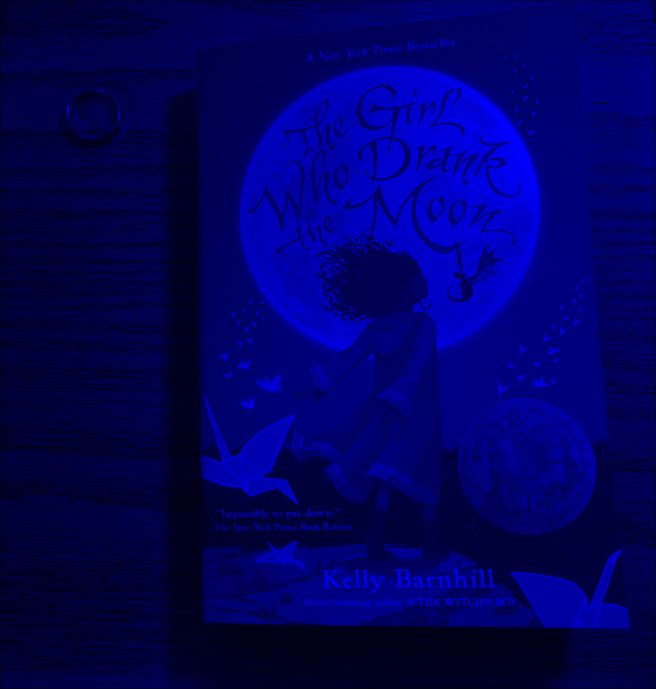

In [12]:
img_r = image2red(img)
img_g = image2green(img)
img_b = image2blue(img)

display(red2Image(img_r))
display(green2Image(img_g))
display(blue2Image(img_b))

In [13]:
U_r, S_r, Vt_r = decompose(img_r)
U_g, S_g, Vt_g = decompose(img_g)
U_b, S_b, Vt_b = decompose(img_b)

count(!iszero, diag(S_r)), count(!iszero, diag(S_g)), count(!iszero, diag(S_b))

(2620, 2620, 2620)

In [14]:
size(img_r), size(img_g), size(img_b)

((2753, 2620), (2753, 2620), (2753, 2620))

Interesting, so the image seems to be complex, since the number of non zero singular values are equal to the number of column vectors in the image matrix

In [15]:
reduce_columns(A::AbstractMatrix, num_cols::Int) = A[:, 1:num_cols]

reduce_columns (generic function with 1 method)

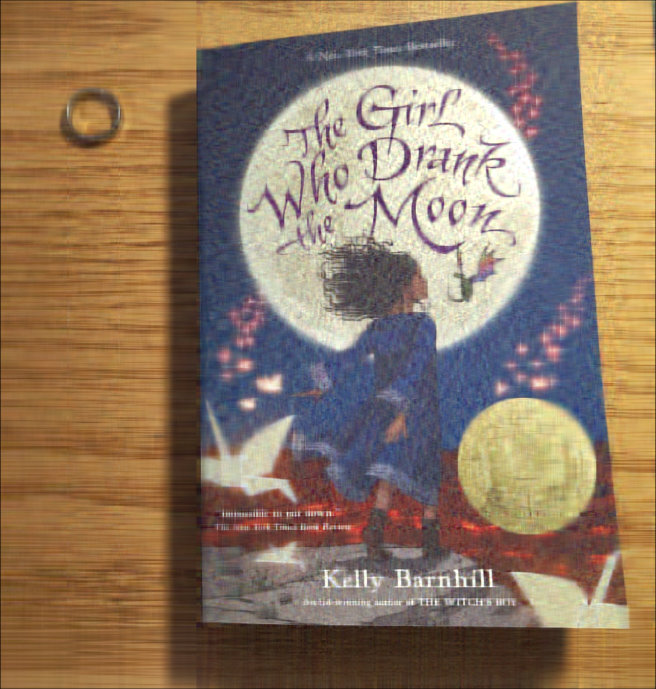

In [16]:
k = 50  # Number of singular values to keep

U_r_k = reduce_columns(U_r, k)
S_r_k = Diagonal(diag(S_r)[1:k])
Vt_r_k = reduce_columns(Vt_r', k)'

U_g_k = reduce_columns(U_g, k)
S_g_k = Diagonal(diag(S_g)[1:k])
Vt_g_k = reduce_columns(Vt_g', k)'

U_b_k = reduce_columns(U_b, k)
S_b_k = Diagonal(diag(S_b)[1:k])
Vt_b_k = reduce_columns(Vt_b', k)'

reduced_r_data = U_r_k * S_r_k * Vt_r_k
reduced_g_data = U_g_k * S_g_k * Vt_g_k
reduced_b_data = U_b_k * S_b_k * Vt_b_k

# img_r_k = red2Image(reduced_r_data)
# img_g_k = green2Image(reduced_g_data)
# img_b_k = blue2Image(reduced_b_data)

reduced_img_rgbdata = combine_rgb_data(reduced_r_data, reduced_g_data, reduced_b_data)
rgbdata2Image(reduced_img_rgbdata)


In [17]:
function compress(img, k=nothing)
    if k==nothing
        return img
    end
    
    img_r = image2red(img)
    img_g = image2green(img)
    img_b = image2blue(img)

    U_r, S_r, Vt_r = decompose(img_r)
    U_g, S_g, Vt_g = decompose(img_g)
    U_b, S_b, Vt_b = decompose(img_b)

    reduce_columns(A::AbstractMatrix, num_cols::Int) = A[:, 1:num_cols]

    U_r_k = reduce_columns(U_r, k)
    S_r_k = Diagonal(diag(S_r)[1:k])
    Vt_r_k = reduce_columns(Vt_r', k)'

    U_g_k = reduce_columns(U_g, k)
    S_g_k = Diagonal(diag(S_g)[1:k])
    Vt_g_k = reduce_columns(Vt_g', k)'

    U_b_k = reduce_columns(U_b, k)
    S_b_k = Diagonal(diag(S_b)[1:k])
    Vt_b_k = reduce_columns(Vt_b', k)'

    reduced_r_data = U_r_k * S_r_k * Vt_r_k
    reduced_g_data = U_g_k * S_g_k * Vt_g_k
    reduced_b_data = U_b_k * S_b_k * Vt_b_k


    reduced_img_rgbdata = combine_rgb_data(reduced_r_data, reduced_g_data, reduced_b_data)
    return rgbdata2Image(reduced_img_rgbdata), (U_r_k, S_r_k, Vt_r_k), (U_g_k, S_g_k, Vt_g_k), (U_b_k, S_b_k, Vt_b_k), count(!iszero, diag(S_r)), count(!iszero, diag(S_g)), count(!iszero, diag(S_b))
end
    

compress (generic function with 2 methods)

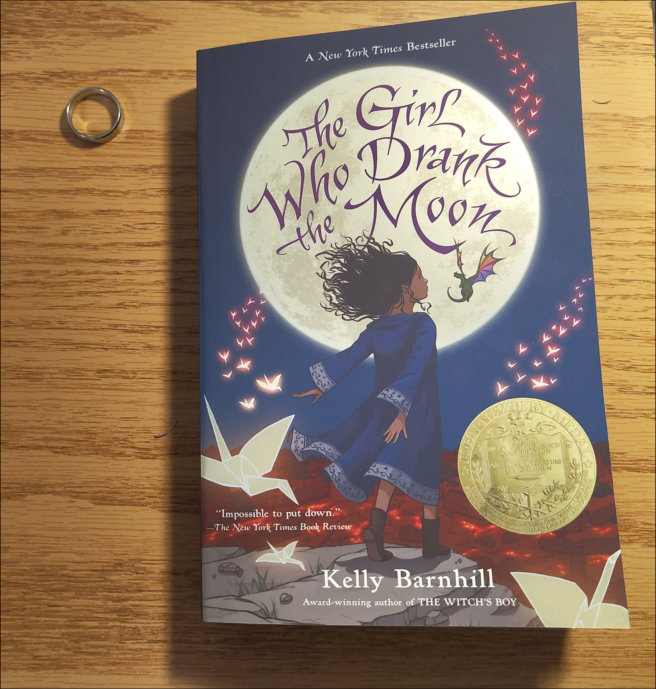

In [18]:
compressed_k1000 = compress(img, 1000)
compressed_k1000[1]

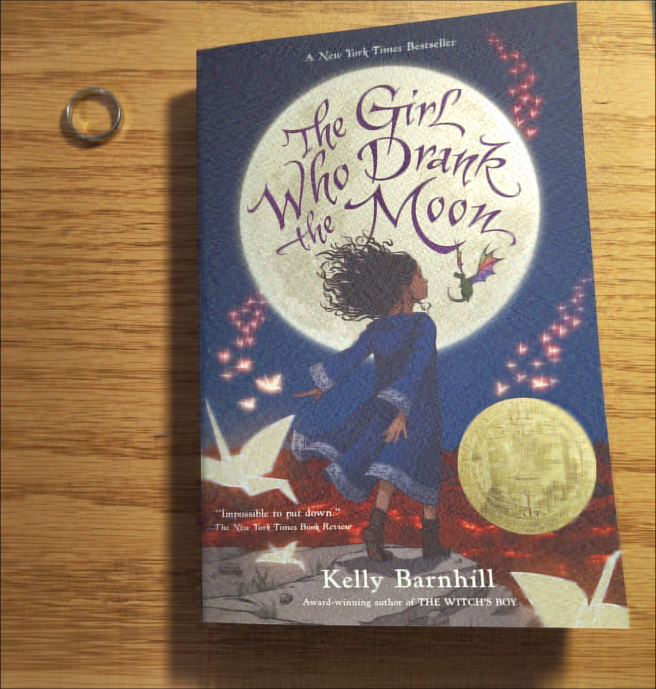

In [19]:
compressed_k100 = compress(img, 100)
compressed_k100[1]

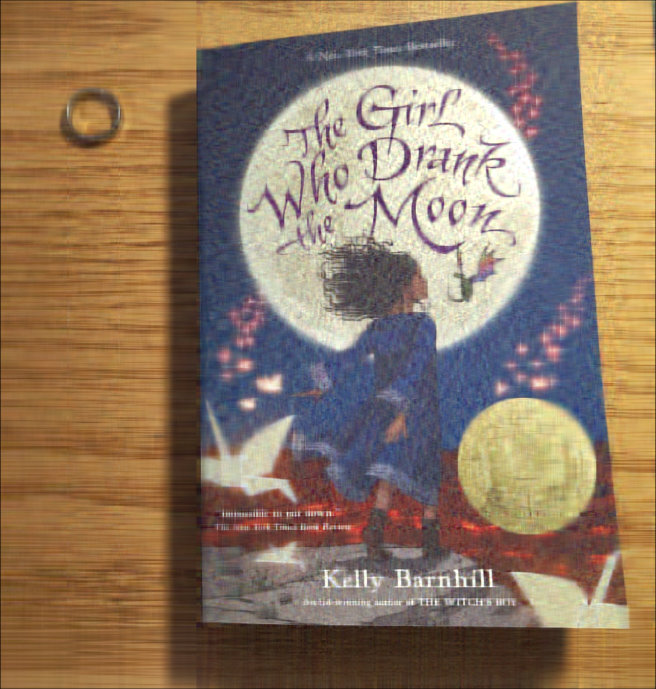

In [20]:
compressed_k50 = compress(img, 50)
compressed_k50[1]

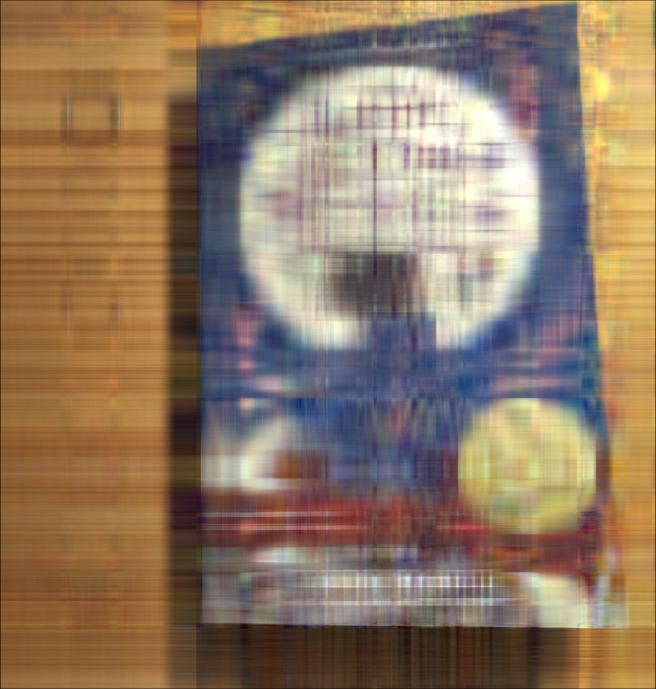

In [21]:
compressed_k10 = compress(img, 10)
compressed_k10[1]

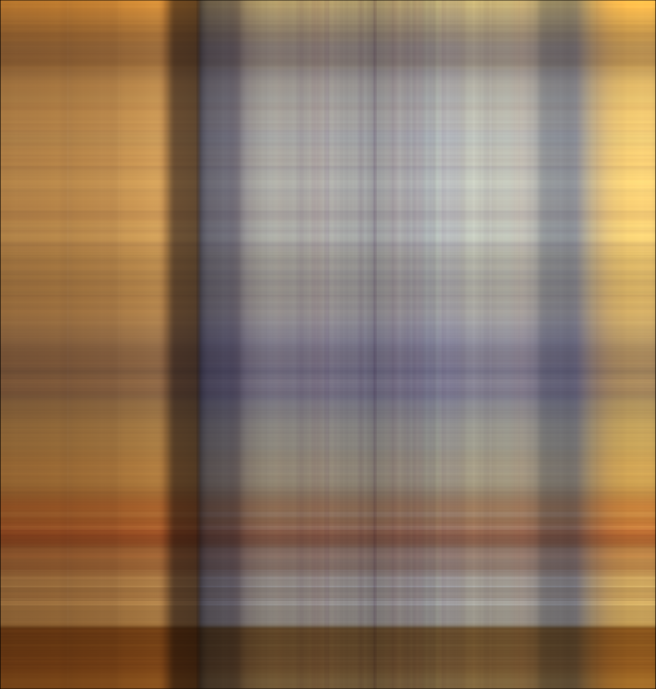

In [22]:
compressed_k1 = compress(img, 1)
compressed_k1[1]

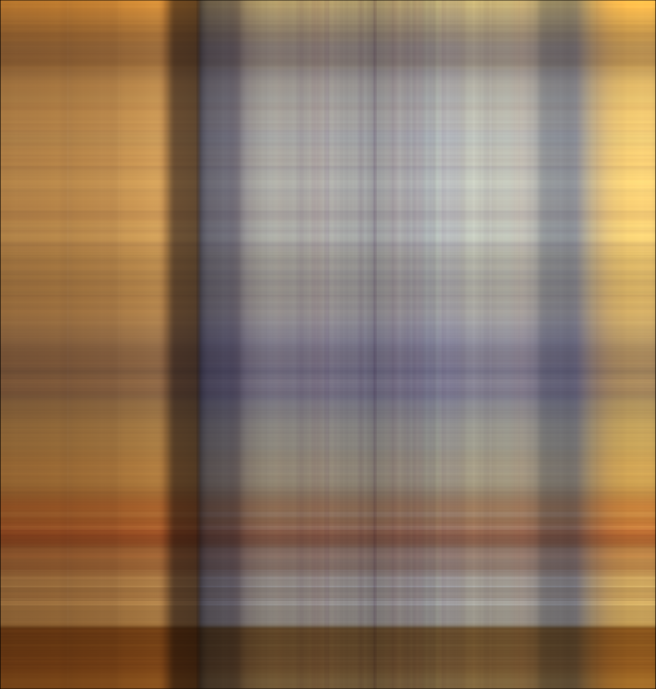

In [23]:
compressed_k1_1 = compress(compressed_k1[1], 1)
compressed_k1_1[1]

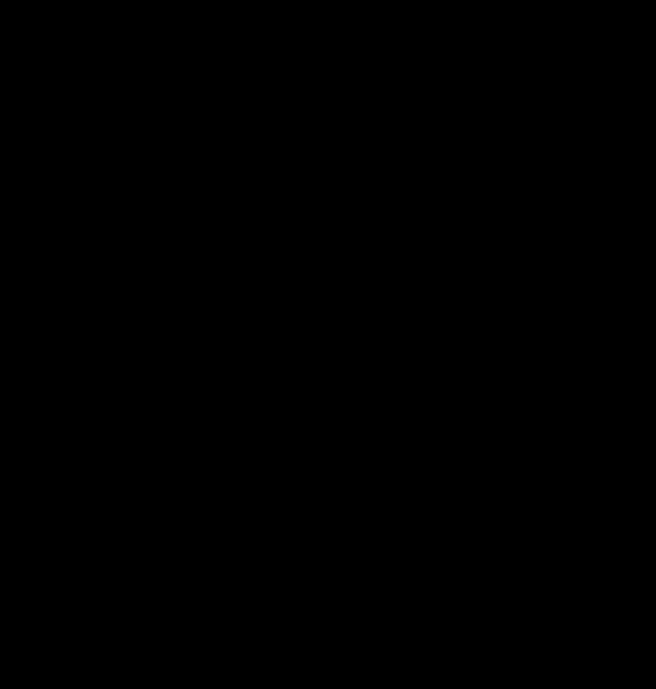

In [24]:
compressed_k0 = compress(img, 0)
compressed_k0[1]

In [26]:
S_r

2620×2620 Diagonal{Float64, Vector{Float64}}:
 1549.9     ⋅        ⋅       ⋅     …   ⋅           ⋅           ⋅ 
     ⋅   247.737     ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅     193.97     ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅    140.827      ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅     …   ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
    ⋮                              ⋱                          
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅   

In [27]:
count(!iszero, diag(compressed_k100[2][2])), count(!iszero, diag(compressed_k100[3][2])), count(!iszero, diag(compressed_k100[4][2]))

(100, 100, 100)

In [28]:
length(compressed_k100[2][1]) + length(diag(compressed_k100[2][2])) + length(compressed_k100[2][3]) + length(compressed_k100[3][1]) + length(diag(compressed_k100[3][2])) + length(compressed_k100[3][3]) + length(compressed_k100[4][1]) + length(diag(compressed_k100[4][2])) + length(compressed_k100[4][3])

1612200

In [29]:
length(img) * 3

21638580

In [30]:
1641900/21638580

0.07587836170395655

In [31]:
length(compressed_k50[2][1]) + length(compressed_k50[2][2]) + length(compressed_k50[2][3]) + length(compressed_k50[3][1]) + length(compressed_k50[3][2]) + length(compressed_k50[3][3]) + length(compressed_k50[4][1]) + length(compressed_k50[4][2]) + length(compressed_k50[4][3])

813450

In [32]:
813450/21638580

0.037592577701494274

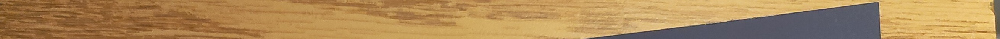

In [33]:
img[1:Int64((size(img,1)*813450/21638580)÷1), :]

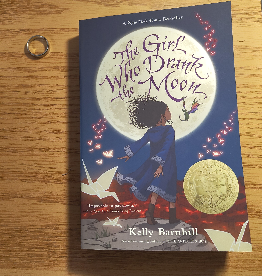

0.010025426807119505


In [34]:
a = img[1:10:end, 1:10:end]
println(length(a)/length(img))
display(a)

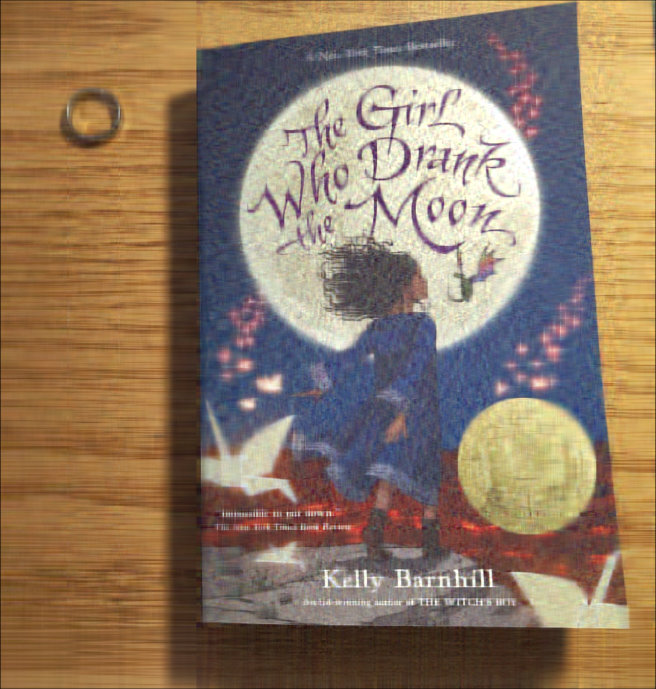

In [35]:
compressed_k50[1]

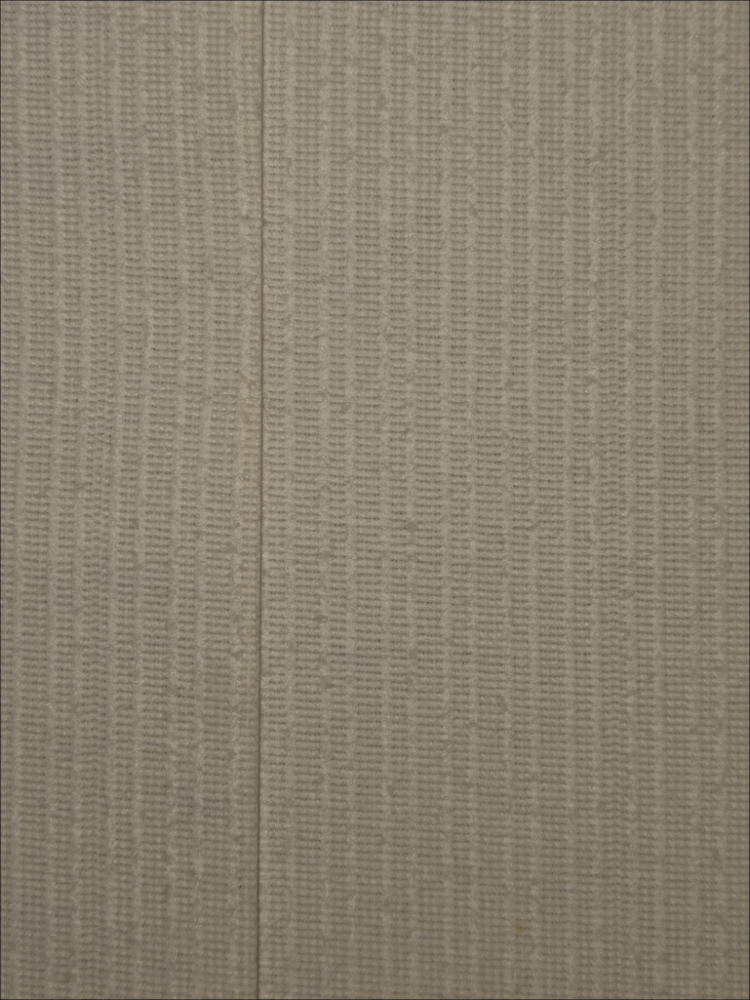

In [36]:
img2 = load("image2.jpg")

In [37]:
length(img2)*3

37748736

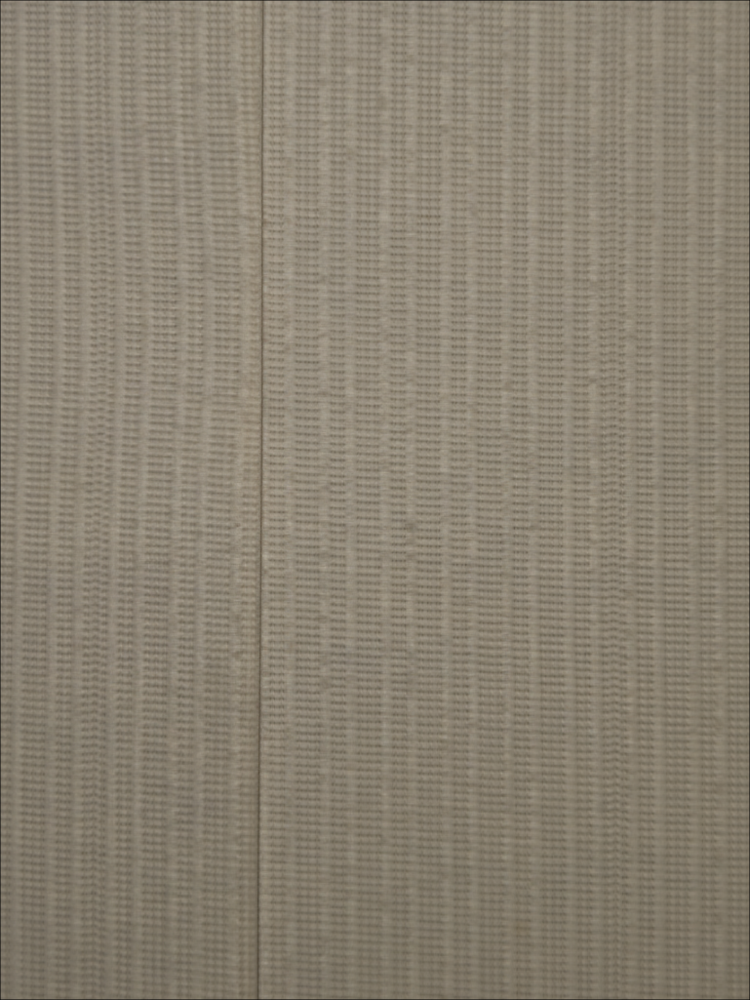

In [38]:
compressed_2_k50 = compress(img2, 50)
compressed_2_k50[1]

In [39]:
length(compressed_2_k50[2][1]) + length(compressed_2_k50[2][2]) + length(compressed_2_k50[2][3]) + length(compressed_2_k50[3][1]) + length(compressed_2_k50[3][2]) + length(compressed_2_k50[3][3]) + length(compressed_2_k50[4][1]) + length(compressed_2_k50[4][2]) + length(compressed_2_k50[4][3])

1082700

In [40]:
1082700/37748736

0.02868175506591797

In [41]:
size(img2)

(4096, 3072)

In [42]:
compressed_2_k50[6]

3072

In [43]:
compressed_2_k50[2][2]

50×50 Diagonal{Float64, Vector{Float64}}:
 1921.24    ⋅       ⋅        ⋅     …   ⋅        ⋅        ⋅       ⋅ 
     ⋅    49.345    ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅     48.0529    ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅      38.867      ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅     …   ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
    ⋮                              ⋱                            
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅      ⋅       ⋅        ⋅         ⋅        ⋅        ⋅       ⋅ 
     ⋅   

In [44]:
(length(compressed_k10[2][1]) + length(compressed_k10[2][2]) + length(compressed_k10[2][3]) + length(compressed_k10[3][1]) + length(compressed_k10[3][2]) + length(compressed_k10[3][3]) + length(compressed_k10[4][1]) + length(compressed_k10[4][2]) + length(compressed_k10[4][3]))/21638580

0.007463059036221416

In [49]:
using FileIO, Images

# Clamp and save each image
save("compressed_k1000.jpg", map(clamp01nan, compressed_k1000[1]))
save("compressed_k100.jpg", map(clamp01nan, compressed_k100[1]))
save("compressed_k50.jpg", map(clamp01nan, compressed_k50[1]))
save("compressed_k10.jpg", map(clamp01nan, compressed_k10[1]))
save("compressed_k1.jpg", map(clamp01nan, compressed_k1[1]))
save("compressed_k1_1.jpg", map(clamp01nan, compressed_k1_1[1]))
save("compressed_k0.jpg", map(clamp01nan, compressed_k0[1]))

114115

In [50]:
save("naive_downsampled.jpg", map(clamp01nan, a))

36407

In [70]:
# Set of orthogonal vectors
S1 = [1.0, 0.0, 0.0]
S2 = [0.0, 1.0, 0.0]
S3 = [0.0, 0.0, 1.0]

# Another set of orthogonal vectors
T1 = normalize([1.0, 1.0, 0.0])
T2 = normalize([0.0, 1.0, 1.0])
T3 = normalize([1.0, 0.0, 1.0])

# Orthonormalize T1, T2, T3 using Gram-Schmidt
T2 -= (T1 ⋅ T2) * T1
T2 = normalize(T2)
T3 -= (T1 ⋅ T3) * T1 + (T2 ⋅ T3) * T2
T3 = normalize(T3)

A = [S1 S2 S3]  # 3x3 matrix with S vectors as columns
B = [T1 T2 T3]  # 3x3 matrix with T vectors as columns

3×3 Matrix{Float64}:
 0.707107  -0.408248   0.57735
 0.707107   0.408248  -0.57735
 0.0        0.816497   0.57735

In [71]:
inv(A) ≈ A'  # Should be true since A is orthogonal
inv(B) ≈ B'  # Should be true since B is orthogonal

true

In [72]:
B * B'

3×3 Matrix{Float64}:
  1.0          -1.11022e-16  5.55112e-17
 -1.11022e-16   1.0          5.55112e-17
  5.55112e-17   5.55112e-17  1.0

In [73]:
S1 ⋅ S2, S2 ⋅ S3, S1 ⋅ S3  # Should all be close to 0

(0.0, 0.0, 0.0)

In [74]:
norm(S1), norm(S2), norm(S3)  # Should all be 1

(1.0, 1.0, 1.0)

In [75]:
T1 ⋅ T2, T2 ⋅ T3, T1 ⋅ T3  # Should all be close to 0

(1.1102230246251565e-16, 0.0, 5.551115123125783e-17)

In [76]:
norm(T1), norm(T2), norm(T3)  # Should all be 1

(0.9999999999999999, 1.0, 1.0)

In [84]:
using LinearAlgebra
tensorprod(A::AbstractMatrix, B::AbstractMatrix) = kron(A, B)
tensorprod(A::AbstractVector, B::AbstractVector) = [A[i] * B[j] for i in 1:length(A), j in 1:length(B)]
trace(M::AbstractMatrix) = sum(diag(M))

A = tensorprod(S1, T1)
B = tensorprod(S2, T2)
C = tensorprod(S3, T3)

3×3 Matrix{Float64}:
 0.0      -0.0      0.0
 0.0      -0.0      0.0
 0.57735  -0.57735  0.57735

In [87]:
display((A * B'))
display((A * C'))
display((B * C'))

3×3 Matrix{Float64}:
 0.0  1.11022e-16  0.0
 0.0  0.0          0.0
 0.0  0.0          0.0

3×3 Matrix{Float64}:
 0.0  0.0  5.55112e-17
 0.0  0.0  0.0
 0.0  0.0  0.0

3×3 Matrix{Float64}:
 0.0  0.0  0.0
 0.0  0.0  0.0
 0.0  0.0  0.0

In [89]:
S_r

2620×2620 Diagonal{Float64, Vector{Float64}}:
 1549.9     ⋅        ⋅       ⋅     …   ⋅           ⋅           ⋅ 
     ⋅   247.737     ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅     193.97     ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅    140.827      ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅     …   ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
    ⋮                              ⋱                          
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅         ⋅           ⋅           ⋅ 
     ⋅      ⋅        ⋅       ⋅   

In [96]:
cumsum_S_r =cumsum(diag(S_r))

# To find the rank r where 75% of the variance is captured
k_optimal = findfirst(x -> x >= 0.75 * cumsum_S_r[end], cumsum_S_r)

245

In [102]:
245 * (4001) / (2000 * 2000)

0.24506125

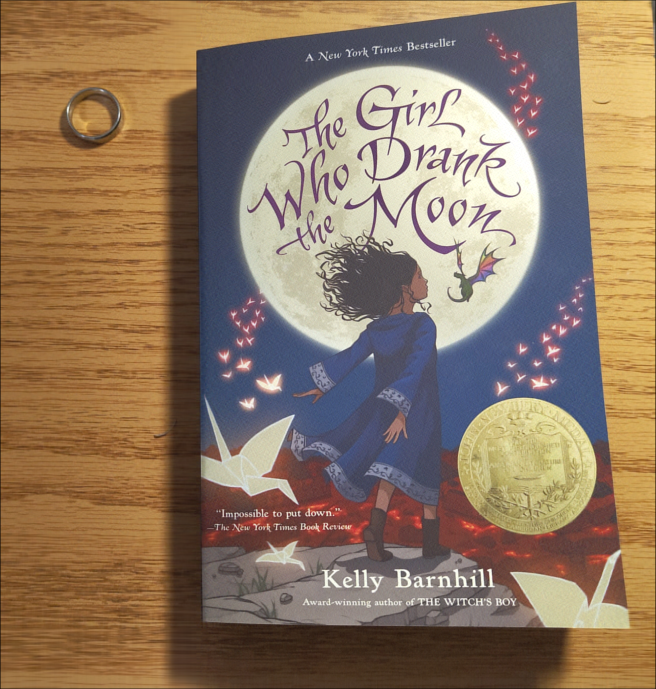

In [100]:
compressed_k245 = compress(img, 245)
compressed_k245[1]

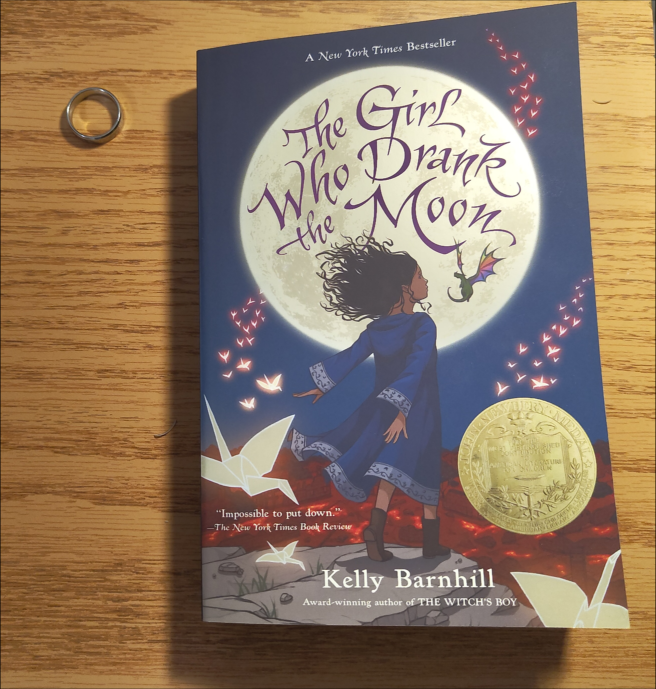

In [101]:
img[1:2:end, 1:2:end]

In [107]:
# Plot for k_opt=findfirst(x -> x >= y * cumsum_S_r[end], cumsum_S_r): y/(k_opt * (size(img,1)+size(img,2))/(size(img,1)*size(img,2))) as a function of y from 0 to 1

ys = 0:0.01:1
k_opts = [findfirst(x -> x >= y * cumsum_S_r[end], cumsum_S_r) for y in ys]
ratios = [y/(k_opt * (size(img,1)+size(img,2))/(size(img,1)*size(img,2))) for (y, k_opt) in zip(ys, k_opts)]


101-element Vector{Float64}:
   0.0
  13.42426949562628
  26.84853899125256
  40.27280848687884
  53.69707798250512
  67.12134747813141
  80.54561697375767
  93.96988646938397
 107.39415596501024
 120.81842546063652
   ⋮
   1.6358050246326064
   1.5132812885978715
   1.3928050028574726
   1.2714911286984014
   1.151679956729332
   1.0310009034645677
   0.9066701657969506
   0.7686539502990178
   0.5123766983063465

In [110]:
# Find index of maximum ratio
max_index = findmax(ratios)[2]

20

In [111]:
ratios[max_index]

255.06112041689934

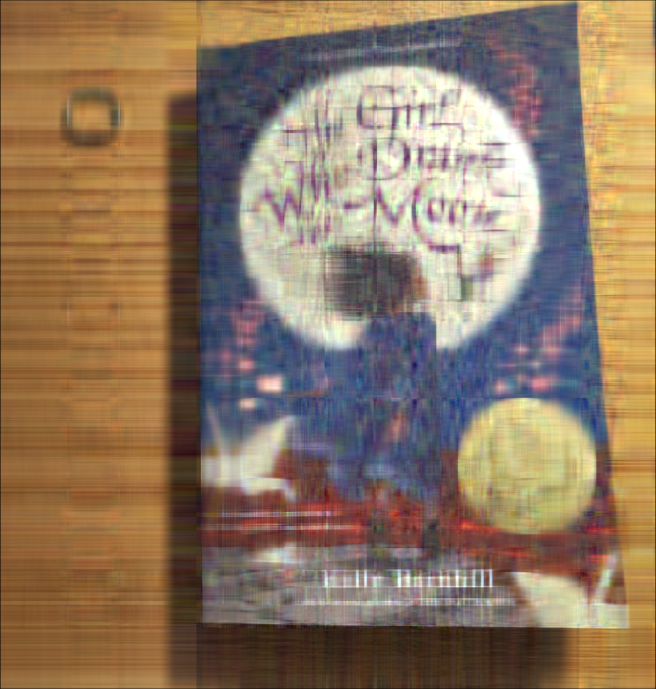

In [112]:
compress(img, 20)[1]

In [113]:
(max_index * (size(img,1)+size(img,2))/(size(img,1)*size(img,2)))

0.01489838982040411

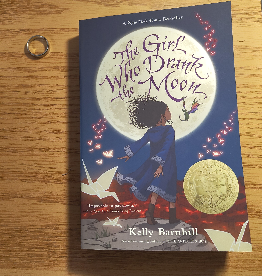

In [115]:
img[1:10:end, 1:10:end]

In [116]:
(1000 * (size(img,1)+size(img,2))/(size(img,1)*size(img,2)))

0.7449194910202056